<a href="https://colab.research.google.com/github/vdoddihithlu/MLModels/blob/main/image_recognition_cocoa_fruit.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 40.0 MB/s eta 0:00:00


In [10]:
from ultralytics import YOLO

# Load a pretrained YOLOv8 model
model = YOLO("yolo26n.pt")   # nano model (fast & small)

In [ ]:
https://app.roboflow.com/

dataset/
│
├─ train/
│   ├─ images/
│   ├─ labels/
│
└─ valid/
│   ├─ images/
│   ├─ labels/
data.yaml


image 1/1 /content/sample_data/v7/valid/images/cacao14-scaled-e1586557021592_webp.rf.764b68cc5aca9c754ac0fa6f93cefd62.jpg: 640x640 1 banana, 1 orange, 317.1ms
Speed: 4.8ms preprocess, 317.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


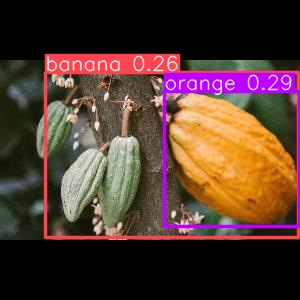

In [9]:
file="/content/sample_data/v7/valid/images/cacao14-scaled-e1586557021592_webp.rf.764b68cc5aca9c754ac0fa6f93cefd62.jpg"
#file="https://ultralytics.com/images/bus.jpg"
results = model(file)
results[0].show()  #v8n


image 1/1 /content/sample_data/v7/valid/images/cacao14-scaled-e1586557021592_webp.rf.764b68cc5aca9c754ac0fa6f93cefd62.jpg: 640x640 1 orange, 189.0ms
Speed: 5.0ms preprocess, 189.0ms inference, 0.3ms postprocess per image at shape (1, 3, 640, 640)


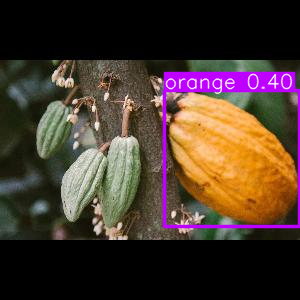

In [11]:
file="/content/sample_data/v7/valid/images/cacao14-scaled-e1586557021592_webp.rf.764b68cc5aca9c754ac0fa6f93cefd62.jpg"
#file="https://ultralytics.com/images/bus.jpg"
results = model(file)
results[0].show()  #26n

/content/sample_data/v7/train/images/cacao3resized-jpg_webp.rf.e15617aec15ac81b90eb53f0964812ac.jpg
/content/sample_data/v7/train/labels/cacao3resized-jpg_webp.rf.e15617aec15ac81b90eb53f0964812ac.txt


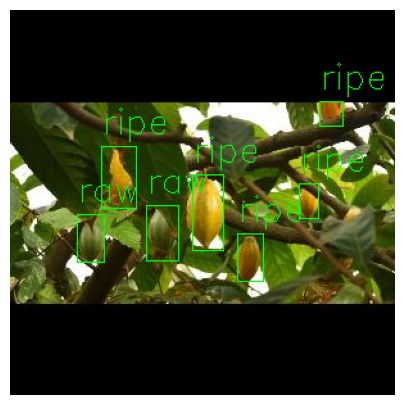

In [15]:
import cv2
import os
import matplotlib.pyplot as plt

def draw_yolo_boxes(image_path, label_path, class_names):
    img = cv2.imread(image_path)
    h, w, _ = img.shape

    # Read YOLO label file
    with open(label_path, "r") as f:
        for line in f.readlines():
            cls, x_center, y_center, width, height = map(float, line.strip().split())

            # Convert from YOLO format to pixel coordinates
            x1 = int((x_center - width/2) * w)
            y1 = int((y_center - height/2) * h)
            x2 = int((x_center + width/2) * w)
            y2 = int((y_center + height/2) * h)

            # Draw rectangle
            cv2.rectangle(img, (x1, y1), (x2, y2), (0,255,0), 1)
            # Label
            cv2.putText(img, class_names[int(cls)], (x1, y1-10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0,255,0), 1)

    # Show image
    plt.figure(figsize=(5,5))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

# Folder with images and labels
images_folder = "/content/sample_data/v7/train/images"
labels_folder = "/content/sample_data/v7/train/labels"

# Class names
class_names = ["raw","ripe"]

# Example: visualize first image
img_file = os.listdir(images_folder)[1]
img_path = os.path.join(images_folder, img_file)
label_path = os.path.join(labels_folder, img_file.replace(".jpg",".txt"))

print(img_path)
print(label_path)

draw_yolo_boxes(img_path, label_path, class_names)

In [16]:
from ultralytics import YOLO
model = YOLO("yolo26n.pt")  # pretrained model

# Train
model.train(
    data="/content/sample_data/v7/data.yaml",
    epochs=20,
    imgsz=300,
    batch=16
)

Ultralytics 8.4.14 🚀 Python-3.12.12 torch-2.9.0+cpu CPU (Intel Xeon CPU @ 2.20GHz)
engine/trainer: agnostic_nms=False, amp=True, angle=1.0, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/sample_data/v7/data.yaml, degrees=0.0, deterministic=True, device=cpu, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, end2end=None, epochs=20, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=300, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo26n.pt, momentum=0.937, mosaic=1.0, multi_scale=0.0, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspect

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7f8842cff770>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.04804

In [22]:
import pandas as pd
import matplotlib.pyplot as plt

# Path to YOLO training results
results_path = "runs/detect/train/results.csv"   # adjust if train2/train3 etc.
df = pd.read_csv(results_path)

df

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,9.56259,1.46436,4.00849,0.01367,0.00445,0.7,0.12172,0.08651,0.99169,4.19130,0.01812,0.000033,0.000033,0.000033
1,2,18.24310,1.57731,3.96259,0.01345,0.00445,0.7,0.06129,0.04520,0.90870,4.16080,0.01603,0.000079,0.000079,0.000079
2,3,28.20260,1.34085,3.82119,0.01152,0.00445,0.7,0.24851,0.20294,0.73598,4.07631,0.01266,0.000120,0.000120,0.000120
3,4,36.20660,1.29318,3.61822,0.01360,0.00527,0.8,0.26874,0.22808,0.73910,4.06860,0.01232,0.000156,0.000156,0.000156
4,5,44.76650,1.25482,3.47552,0.01417,0.00445,0.7,0.26902,0.23190,0.68864,4.05848,0.01170,0.000187,0.000187,0.000187
5,6,53.24800,1.21844,3.46175,0.01004,0.00445,0.7,0.24517,0.19036,0.72440,4.06802,0.01239,0.000213,0.000213,0.000213
6,7,61.39240,1.10302,3.36857,0.01221,0.00445,0.7,0.21337,0.17811,0.67353,4.05531,0.01149,0.000234,0.000234,0.000234
7,8,70.07210,1.09170,3.21066,0.01091,0.00445,0.7,0.15095,0.12160,0.64804,4.05039,0.01091,0.000251,0.000251,0.000251
8,9,78.66750,1.12001,3.16539,0.01167,0.00445,0.7,0.12636,0.10666,0.62795,4.04046,0.01040,0.000262,0.000262,0.000262
9,10,86.61590,1.27833,3.15822,0.01164,0.00527,0.8,0.10389,0.08933,0.61586,4.04257,0.01010,0.000268,0.000268,0.000268


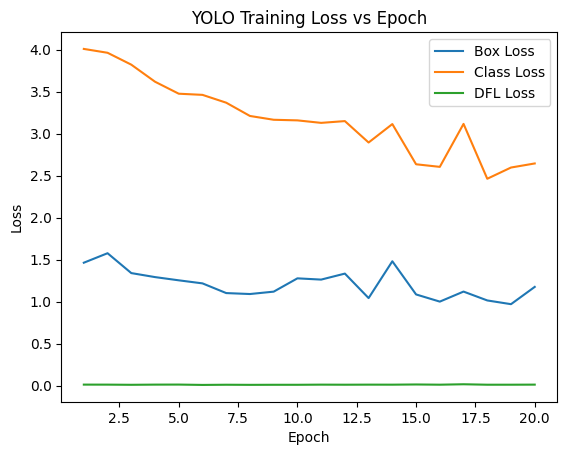

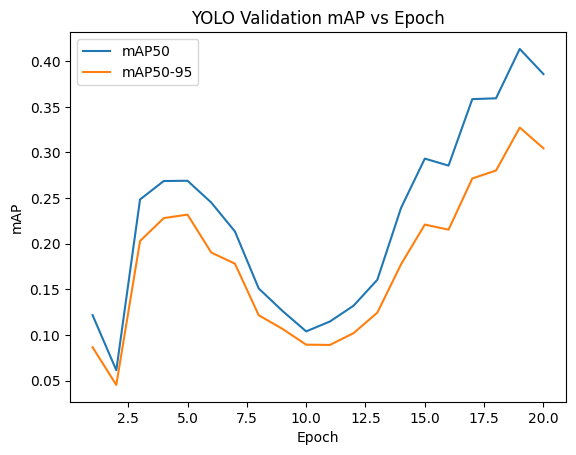

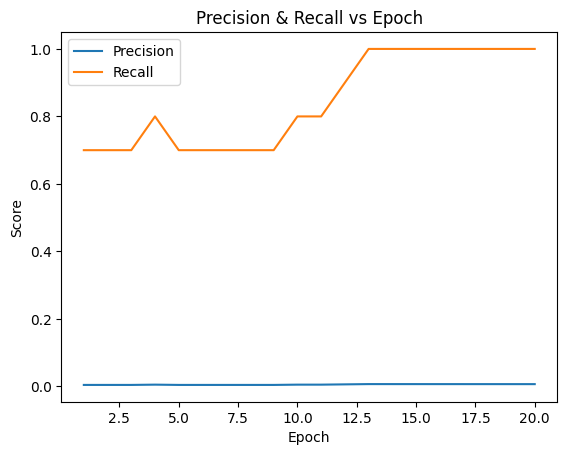

In [21]:

# ---- Plot 1: Training Losses ----
plt.figure()
plt.plot(df['epoch'], df['train/box_loss'])
plt.plot(df['epoch'], df['train/cls_loss'])
plt.plot(df['epoch'], df['train/dfl_loss'])

plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("YOLO Training Loss vs Epoch")
plt.legend(["Box Loss", "Class Loss", "DFL Loss"])
plt.show()


# ---- Plot 2: Validation mAP ----
plt.figure()
plt.plot(df['epoch'], df['metrics/mAP50(B)'])
plt.plot(df['epoch'], df['metrics/mAP50-95(B)'])

plt.xlabel("Epoch")
plt.ylabel("mAP")
plt.title("YOLO Validation mAP vs Epoch")
plt.legend(["mAP50", "mAP50-95"])
plt.show()


# ---- Plot 3: Precision & Recall ----
plt.figure()
plt.plot(df['epoch'], df['metrics/precision(B)'])
plt.plot(df['epoch'], df['metrics/recall(B)'])

plt.xlabel("Epoch")
plt.ylabel("Score")
plt.title("Precision & Recall vs Epoch")
plt.legend(["Precision", "Recall"])
plt.show()


In [17]:
# Load best model
fruit_model = YOLO("/content/runs/detect/train/weights/best.pt")

In [70]:
results = fruit_model.val(data="/content/sample_data/v7/data.yaml", conf=0.019)
results.confusion_matrix

Ultralytics 8.4.14 🚀 Python-3.12.12 torch-2.9.0+cpu CPU (Intel Xeon CPU @ 2.20GHz)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 453.1±108.6 MB/s, size: 15.0 KB)
val: Scanning /content/sample_data/v7/valid/labels... 39 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 39/39 1.6Kit/s 0.0s
val: New cache created: /content/sample_data/v7/valid/labels.cache
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 3/3 1.3s/it 3.8s
                   all         39        110      0.694      0.331      0.497      0.373
                   raw         21         52          1     0.0577      0.529      0.389
                  ripe         28         58      0.389      0.603      0.466      0.358
Speed: 1.4ms preprocess, 84.4ms inference, 0.0ms loss, 0.1ms postprocess per image
Results saved to /content/runs/detect/val9



image 1/1 /content/sample_data/v7/test/images/grow-cocoa-tree.jpg: 224x320 2 ripes, 84.5ms
Speed: 5.3ms preprocess, 84.5ms inference, 0.3ms postprocess per image at shape (1, 3, 224, 320)


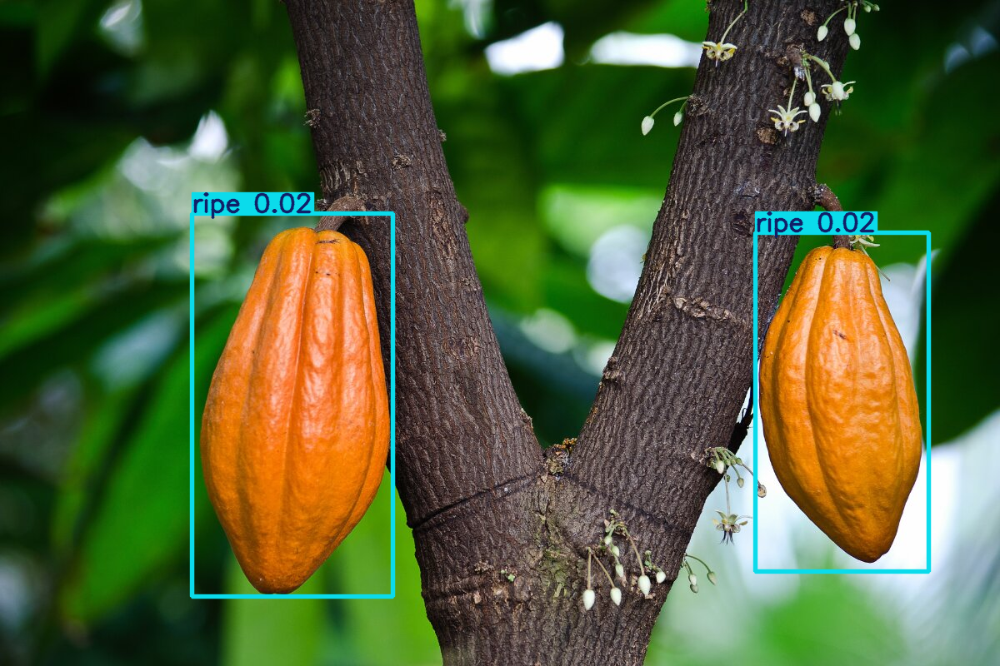

In [56]:
# Detect on new image
file="/content/sample_data/v7/test/images/grow-cocoa-tree.jpg"
results =fruit_model.predict(file, conf=0.019)
results[0].show()

In [59]:
print(results[0].names)
print(results[0].boxes.xyxy)
print ("##########################")
print(results[0].boxes)
#results[0]

{0: 'raw', 1: 'ripe'}
tensor([[ 230.3683,  256.5658,  471.8732,  716.3090],
        [ 906.7386,  279.2234, 1114.4098,  686.5545]])
##########################
ultralytics.engine.results.Boxes object with attributes:

cls: tensor([1., 1.])
conf: tensor([0.0249, 0.0194])
data: tensor([[2.3037e+02, 2.5657e+02, 4.7187e+02, 7.1631e+02, 2.4866e-02, 1.0000e+00],
        [9.0674e+02, 2.7922e+02, 1.1144e+03, 6.8655e+02, 1.9445e-02, 1.0000e+00]])
id: None
is_track: False
orig_shape: (800, 1200)
shape: torch.Size([2, 6])
xywh: tensor([[ 351.1208,  486.4374,  241.5049,  459.7432],
        [1010.5742,  482.8889,  207.6711,  407.3311]])
xywhn: tensor([[0.2926, 0.6080, 0.2013, 0.5747],
        [0.8421, 0.6036, 0.1731, 0.5092]])
xyxy: tensor([[ 230.3683,  256.5658,  471.8732,  716.3090],
        [ 906.7386,  279.2234, 1114.4098,  686.5545]])
xyxyn: tensor([[0.1920, 0.3207, 0.3932, 0.8954],
        [0.7556, 0.3490, 0.9287, 0.8582]])


In [45]:
results[0].boxes
for box in results[0].boxes:
    cls_id = int(box.cls[0])

    if cls_id == 0:
        xyxy = box.xyxy[0].tolist()
        print("Box Coordinates:", xyxy)

ultralytics.engine.results.Boxes object with attributes:

cls: tensor([1.])
conf: tensor([0.0221])
data: tensor([[9.9667e+01, 1.3202e+02, 1.4251e+02, 2.2891e+02, 2.2103e-02, 1.0000e+00]])
id: None
is_track: False
orig_shape: (300, 300)
shape: torch.Size([1, 6])
xywh: tensor([[121.0869, 180.4645,  42.8393,  96.8876]])
xywhn: tensor([[0.4036, 0.6015, 0.1428, 0.3230]])
xyxy: tensor([[ 99.6672, 132.0207, 142.5065, 228.9083]])
xyxyn: tensor([[0.3322, 0.4401, 0.4750, 0.7630]])


/content/sample_data/v7/test/images/images (8).jpg

image 1/1 /content/sample_data/v7/test/images/images (8).jpg: 224x320 (no detections), 71.6ms
Speed: 1.9ms preprocess, 71.6ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 320)


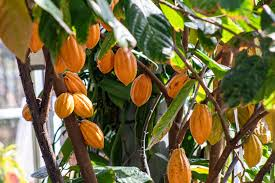

/content/sample_data/v7/test/images/grow-cocoa-tree.jpg

image 1/1 /content/sample_data/v7/test/images/grow-cocoa-tree.jpg: 224x320 2 ripes, 59.2ms
Speed: 1.7ms preprocess, 59.2ms inference, 0.4ms postprocess per image at shape (1, 3, 224, 320)


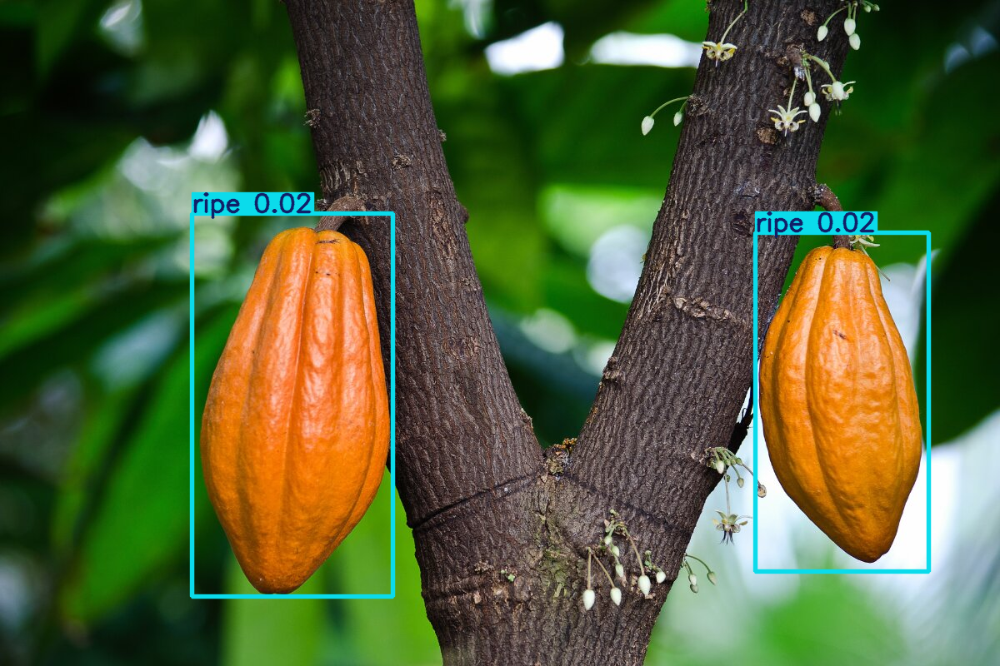

/content/sample_data/v7/test/images/cocoa-tree-theobroma-cacao-with-yellow-fruit-T709JY.jpg

image 1/1 /content/sample_data/v7/test/images/cocoa-tree-theobroma-cacao-with-yellow-fruit-T709JY.jpg: 256x320 1 ripe, 97.4ms
Speed: 2.2ms preprocess, 97.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 320)


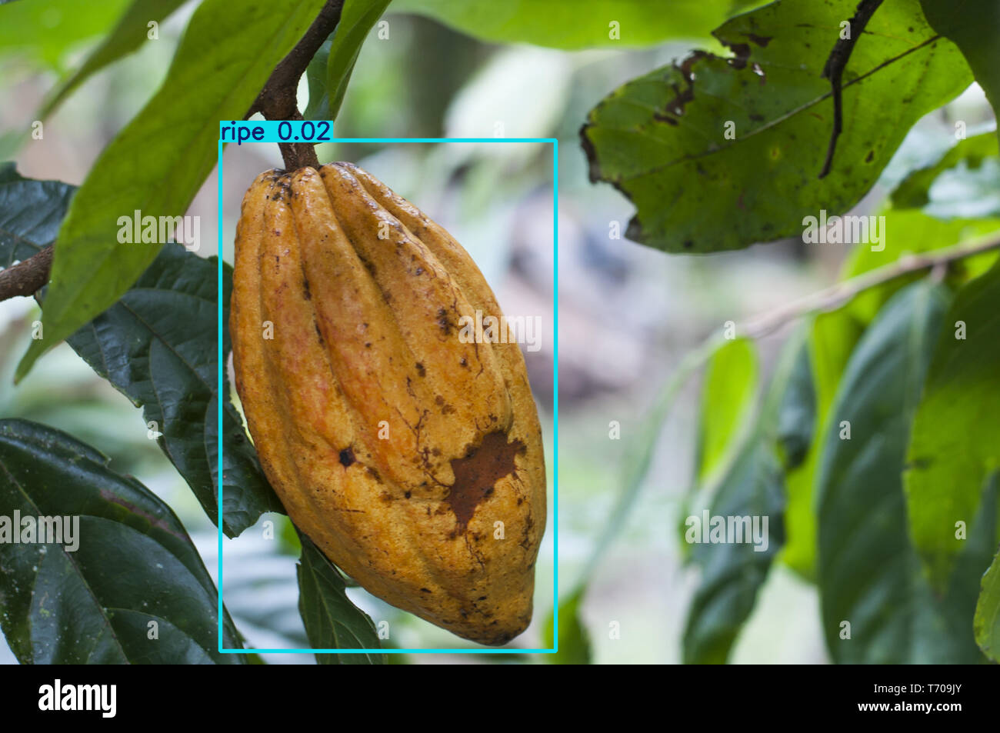

/content/sample_data/v7/test/images/theobroma-cacao-cocoa-fruit-lives-many-tropical-countries-raw-material-making-delicious-chocolate-345360033.webp

image 1/1 /content/sample_data/v7/test/images/theobroma-cacao-cocoa-fruit-lives-many-tropical-countries-raw-material-making-delicious-chocolate-345360033.webp: 320x224 (no detections), 107.4ms
Speed: 1.7ms preprocess, 107.4ms inference, 0.5ms postprocess per image at shape (1, 3, 320, 224)


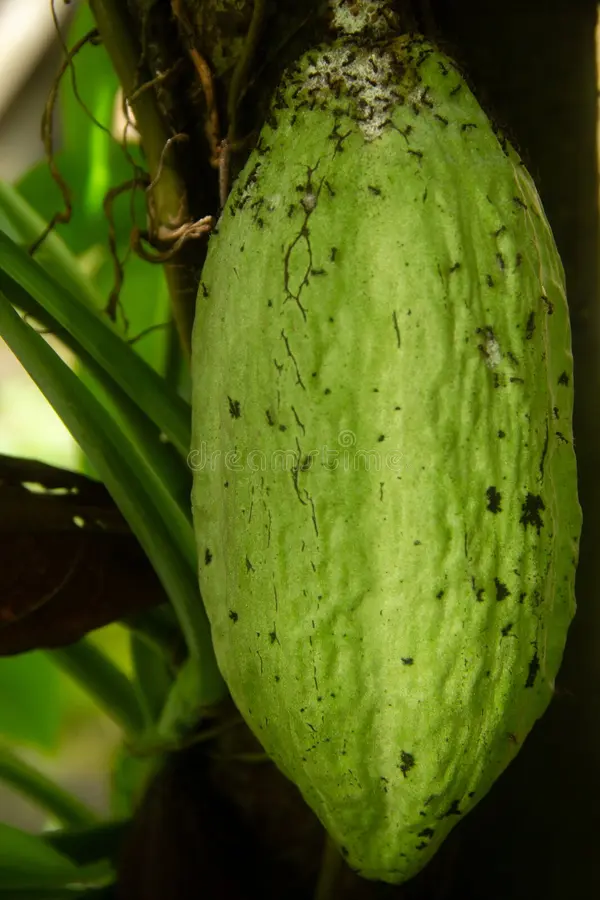

/content/sample_data/v7/test/images/fresh-cocoa-fruit-cacao-tree-146822366.webp

image 1/1 /content/sample_data/v7/test/images/fresh-cocoa-fruit-cacao-tree-146822366.webp: 224x320 (no detections), 74.6ms
Speed: 1.8ms preprocess, 74.6ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 320)


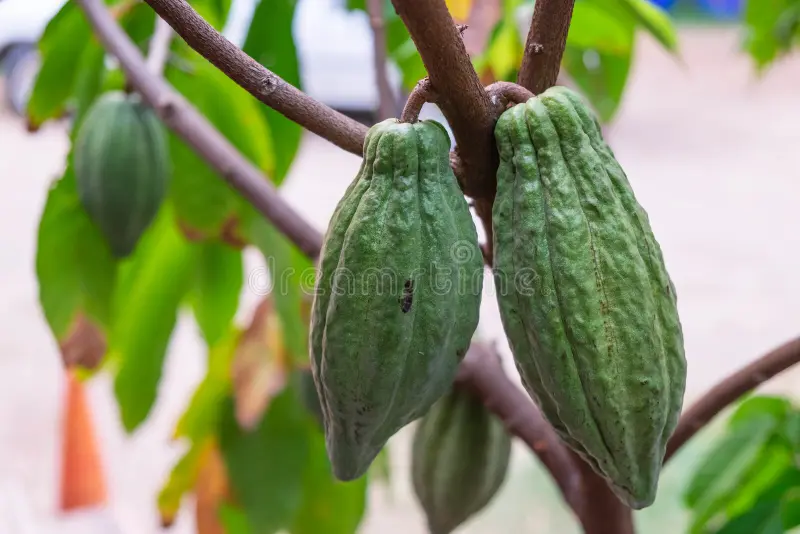

/content/sample_data/v7/test/images/d6704180a44f3ce54055c103b4cb1a8b.webp

image 1/1 /content/sample_data/v7/test/images/d6704180a44f3ce54055c103b4cb1a8b.webp: 224x320 (no detections), 71.1ms
Speed: 1.8ms preprocess, 71.1ms inference, 0.4ms postprocess per image at shape (1, 3, 224, 320)


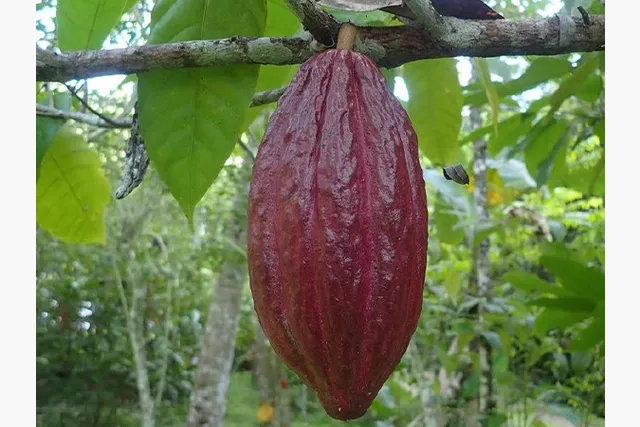

/content/sample_data/v7/test/images/images (3).jpg

image 1/1 /content/sample_data/v7/test/images/images (3).jpg: 256x320 3 ripes, 98.2ms
Speed: 1.3ms preprocess, 98.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 320)


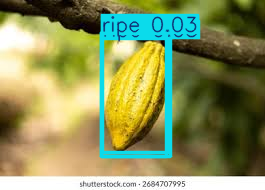

/content/sample_data/v7/test/images/fresh-cocoa-fruit-from-cocoa-trees-free-photo.jpg

image 1/1 /content/sample_data/v7/test/images/fresh-cocoa-fruit-from-cocoa-trees-free-photo.jpg: 224x320 (no detections), 71.8ms
Speed: 1.9ms preprocess, 71.8ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 320)


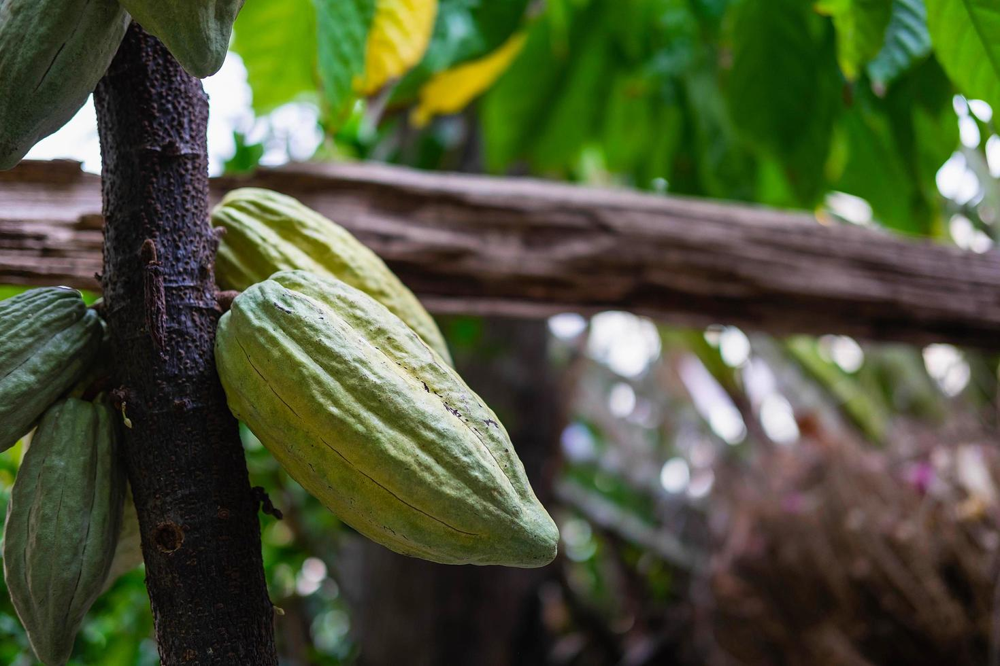

/content/sample_data/v7/test/images/images.jpg

image 1/1 /content/sample_data/v7/test/images/images.jpg: 256x320 (no detections), 85.3ms
Speed: 1.8ms preprocess, 85.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 320)


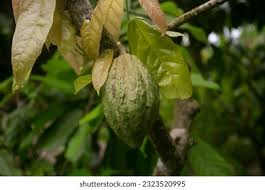

/content/sample_data/v7/test/images/images (1).jpg

image 1/1 /content/sample_data/v7/test/images/images (1).jpg: 256x320 1 raw, 1 ripe, 81.2ms
Speed: 1.4ms preprocess, 81.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 320)


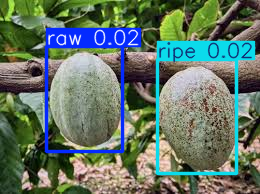

/content/sample_data/v7/test/images/images (6).jpg

image 1/1 /content/sample_data/v7/test/images/images (6).jpg: 224x320 (no detections), 68.2ms
Speed: 1.2ms preprocess, 68.2ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 320)


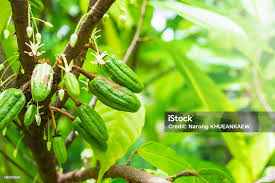

/content/sample_data/v7/test/images/s-l400.jpg

image 1/1 /content/sample_data/v7/test/images/s-l400.jpg: 320x256 (no detections), 94.6ms
Speed: 1.5ms preprocess, 94.6ms inference, 0.5ms postprocess per image at shape (1, 3, 320, 256)


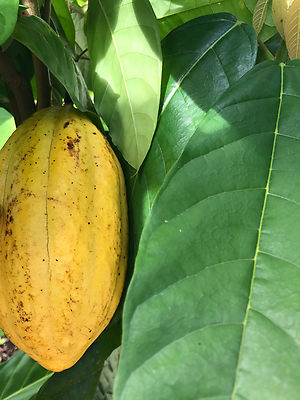

/content/sample_data/v7/test/images/unripe-cacao-pods-grow-trees-cocoa-tree-theobroma-cacao-with-fruits-green-cacao_51137-9124.avif

image 1/1 /content/sample_data/v7/test/images/unripe-cacao-pods-grow-trees-cocoa-tree-theobroma-cacao-with-fruits-green-cacao_51137-9124.avif: 256x320 (no detections), 82.1ms
Speed: 1.6ms preprocess, 82.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 320)


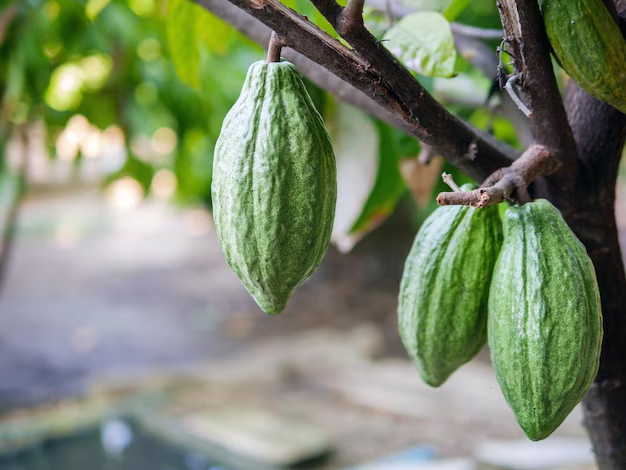

/content/sample_data/v7/test/images/cocoa-theobroma-cacao-is-a-small-evergreen-tree-which-grow-v0-ncc42st02ji81.webp

image 1/1 /content/sample_data/v7/test/images/cocoa-theobroma-cacao-is-a-small-evergreen-tree-which-grow-v0-ncc42st02ji81.webp: 320x160 (no detections), 99.6ms
Speed: 1.3ms preprocess, 99.6ms inference, 0.4ms postprocess per image at shape (1, 3, 320, 160)


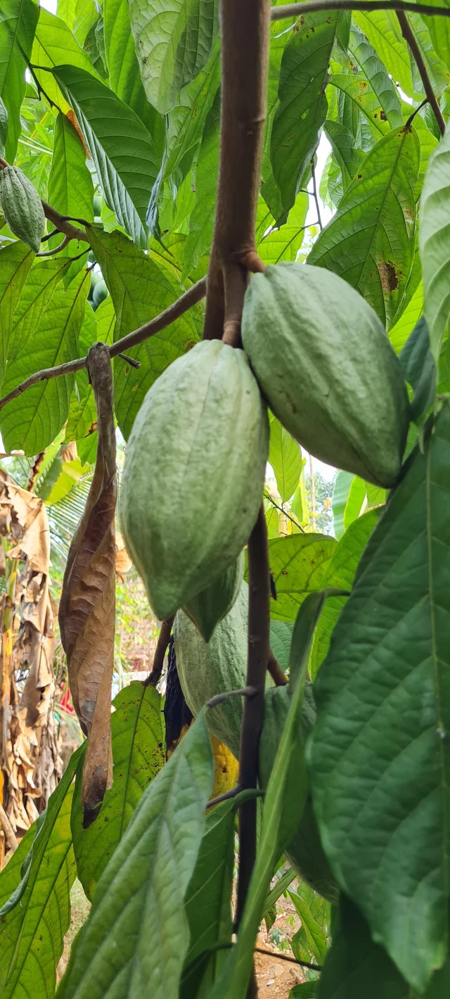

/content/sample_data/v7/test/images/cocoa-cacao-chocolate-nut-tree-fruit-shaped-like-a-papaya-on-the-trunk-or-branches-gourd-like-skin-thick-skin-cocoa-beans-are-processed-into-chocolate-soft-and-selective-focus-photo.jpg

image 1/1 /content/sample_data/v7/test/images/cocoa-cacao-chocolate-nut-tree-fruit-shaped-like-a-papaya-on-the-trunk-or-branches-gourd-like-skin-thick-skin-cocoa-beans-are-processed-into-chocolate-soft-and-selective-focus-photo.jpg: 224x320 1 ripe, 71.9ms
Speed: 1.6ms preprocess, 71.9ms inference, 0.4ms postprocess per image at shape (1, 3, 224, 320)


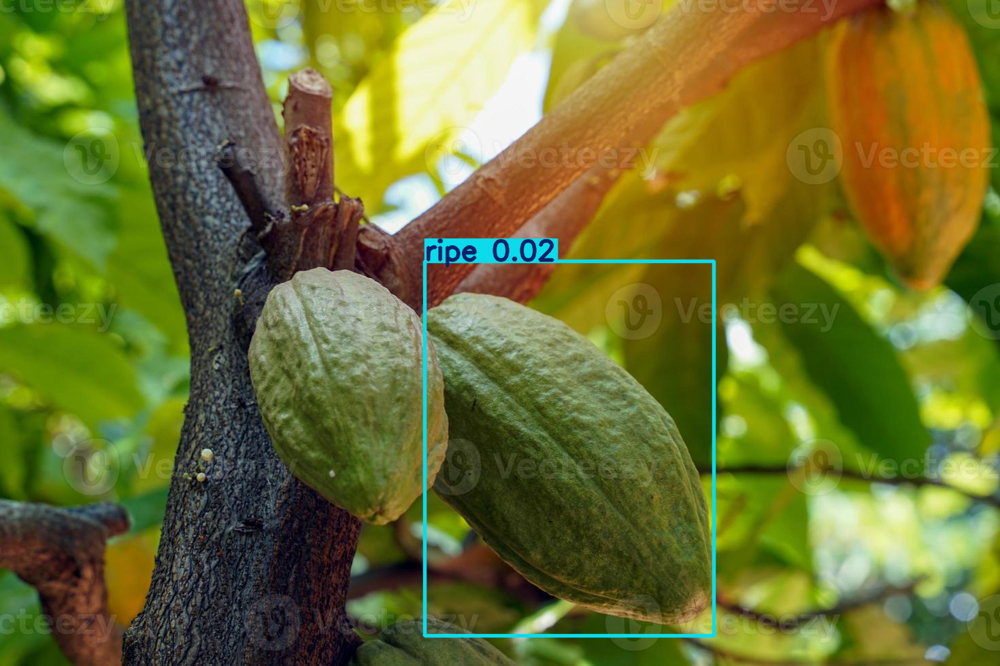

/content/sample_data/v7/test/images/cacao-tree-fruit-pods-close-up_37874-3995.avif

image 1/1 /content/sample_data/v7/test/images/cacao-tree-fruit-pods-close-up_37874-3995.avif: 224x320 (no detections), 72.3ms
Speed: 1.4ms preprocess, 72.3ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 320)


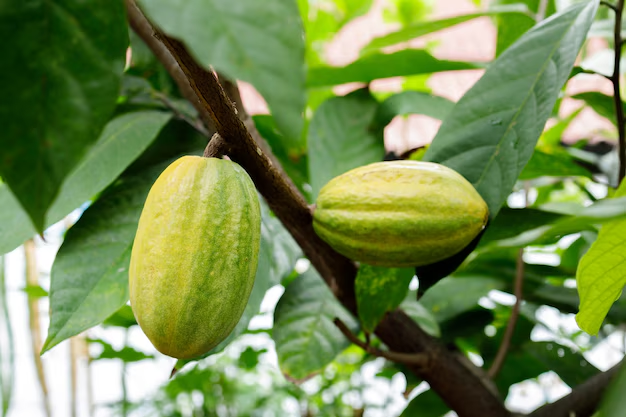

/content/sample_data/v7/test/images/cacao-tree-theobroma-cacao-organic-cocoa-fruit-pods-nature_37874-1133.avif

image 1/1 /content/sample_data/v7/test/images/cacao-tree-theobroma-cacao-organic-cocoa-fruit-pods-nature_37874-1133.avif: 224x320 (no detections), 94.2ms
Speed: 2.0ms preprocess, 94.2ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 320)


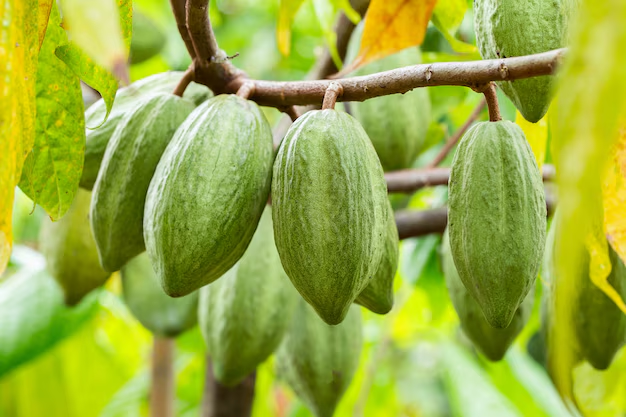

/content/sample_data/v7/test/images/kakaofrucht-single-origin-schokolade_480x480.jpg

image 1/1 /content/sample_data/v7/test/images/kakaofrucht-single-origin-schokolade_480x480.jpg: 320x320 3 ripes, 88.5ms
Speed: 4.1ms preprocess, 88.5ms inference, 0.4ms postprocess per image at shape (1, 3, 320, 320)


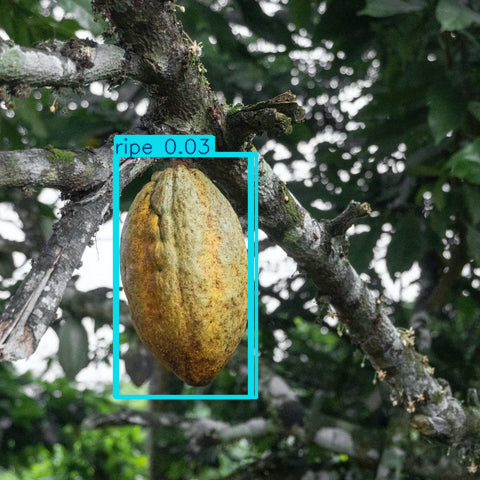

/content/sample_data/v7/test/images/cocoa-tree-theobroma-cacao-cocoa-fruit-cordillera-oriental-dominican-republic-W8T3BD.jpg

image 1/1 /content/sample_data/v7/test/images/cocoa-tree-theobroma-cacao-cocoa-fruit-cordillera-oriental-dominican-republic-W8T3BD.jpg: 320x224 (no detections), 73.9ms
Speed: 1.7ms preprocess, 73.9ms inference, 0.5ms postprocess per image at shape (1, 3, 320, 224)


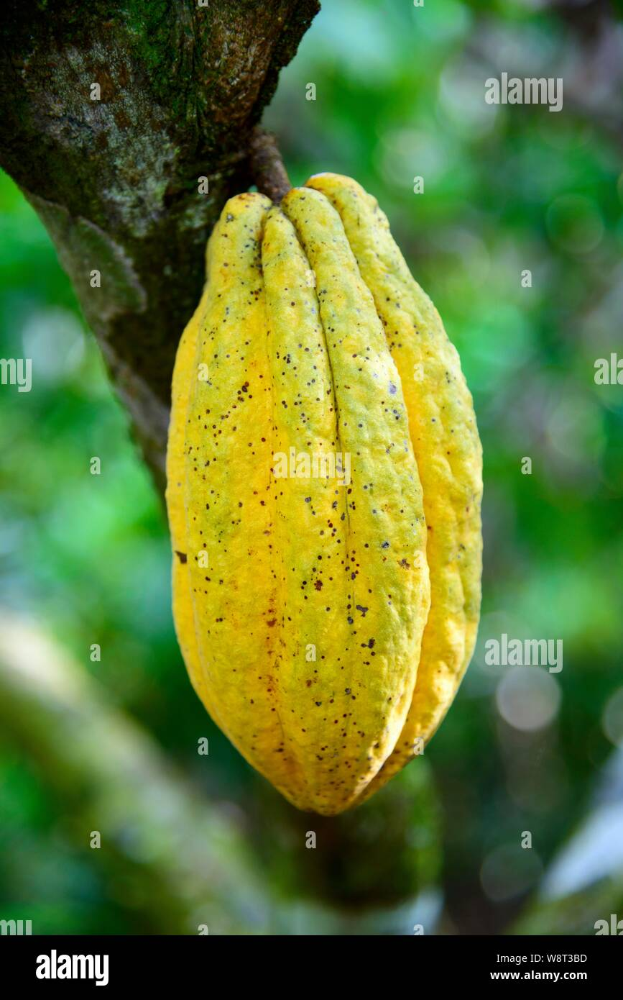

/content/sample_data/v7/test/images/theobroma-cacao-cocoa-plant-tree-huge-beans-hanging-bark-ready-harvest-used-production-chocolate-172883245.webp

image 1/1 /content/sample_data/v7/test/images/theobroma-cacao-cocoa-plant-tree-huge-beans-hanging-bark-ready-harvest-used-production-chocolate-172883245.webp: 320x224 (no detections), 73.0ms
Speed: 1.8ms preprocess, 73.0ms inference, 0.4ms postprocess per image at shape (1, 3, 320, 224)


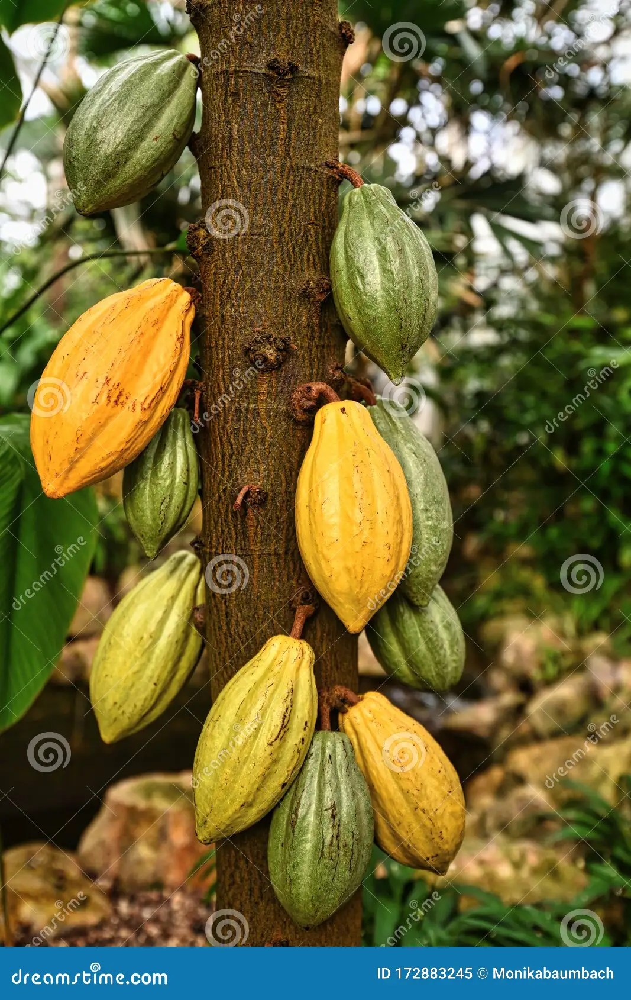

/content/sample_data/v7/test/images/il_fullxfull.7565084981_kmc8.webp

image 1/1 /content/sample_data/v7/test/images/il_fullxfull.7565084981_kmc8.webp: 320x320 4 ripes, 161.3ms
Speed: 2.8ms preprocess, 161.3ms inference, 0.4ms postprocess per image at shape (1, 3, 320, 320)


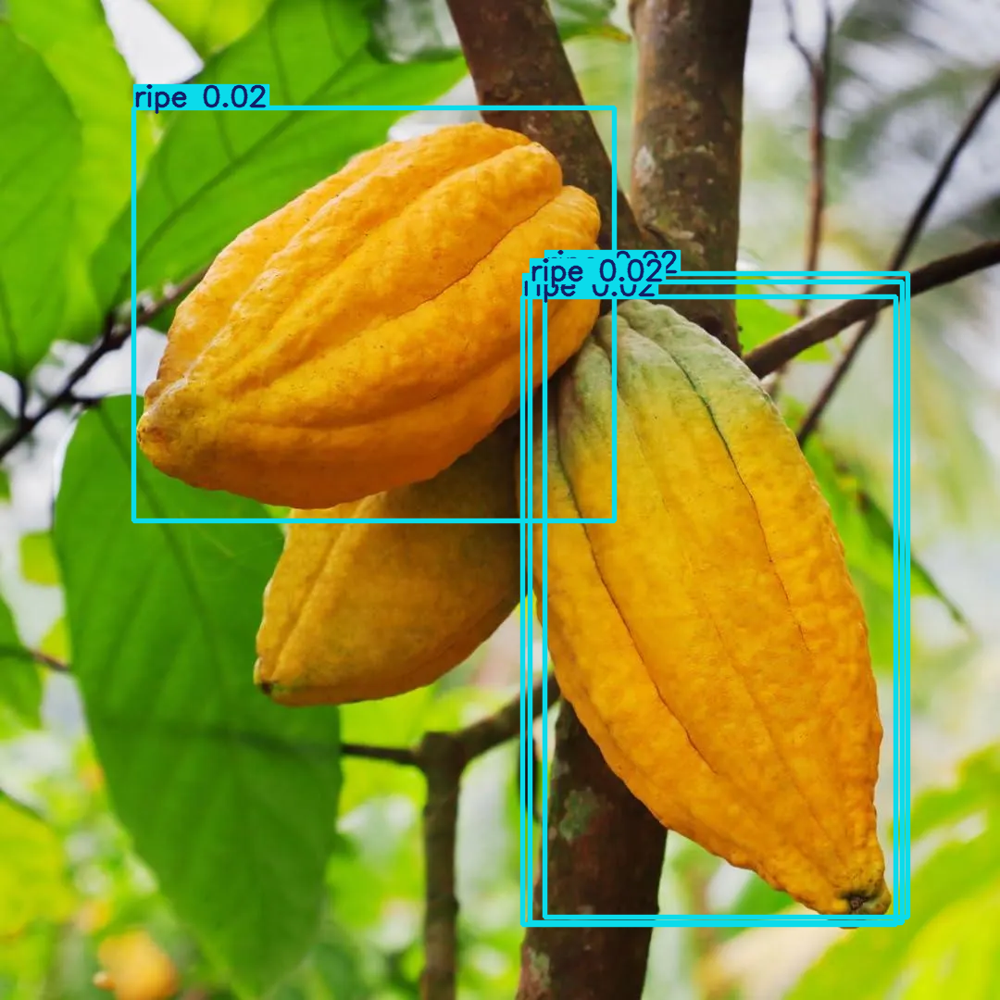

/content/sample_data/v7/test/images/organic-cocoa-fruit-pods-nature_37874-662.avif

image 1/1 /content/sample_data/v7/test/images/organic-cocoa-fruit-pods-nature_37874-662.avif: 320x224 2 ripes, 70.4ms
Speed: 1.4ms preprocess, 70.4ms inference, 0.5ms postprocess per image at shape (1, 3, 320, 224)


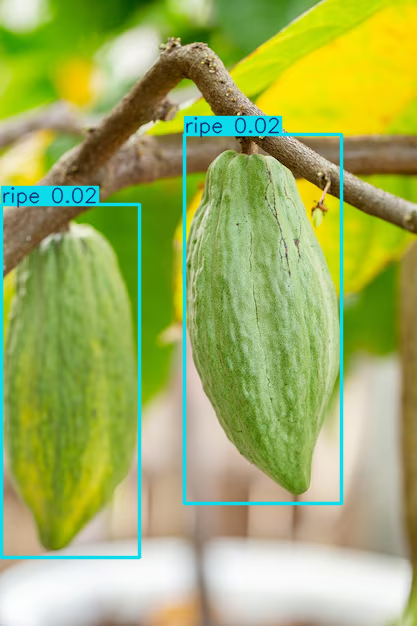

/content/sample_data/v7/test/images/images (5).jpg

image 1/1 /content/sample_data/v7/test/images/images (5).jpg: 288x320 (no detections), 125.0ms
Speed: 1.6ms preprocess, 125.0ms inference, 0.5ms postprocess per image at shape (1, 3, 288, 320)


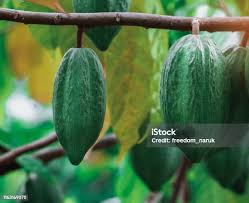

/content/sample_data/v7/test/images/images (2).jpg

image 1/1 /content/sample_data/v7/test/images/images (2).jpg: 320x192 1 ripe, 90.8ms
Speed: 1.5ms preprocess, 90.8ms inference, 0.3ms postprocess per image at shape (1, 3, 320, 192)


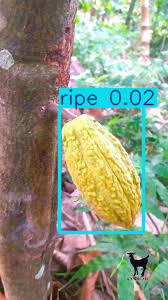

/content/sample_data/v7/test/images/Layer27_1946x_391f24ef-4380-4488-a72e-89cd0f4f68b5.webp

image 1/1 /content/sample_data/v7/test/images/Layer27_1946x_391f24ef-4380-4488-a72e-89cd0f4f68b5.webp: 320x320 3 ripes, 91.7ms
Speed: 2.0ms preprocess, 91.7ms inference, 0.5ms postprocess per image at shape (1, 3, 320, 320)


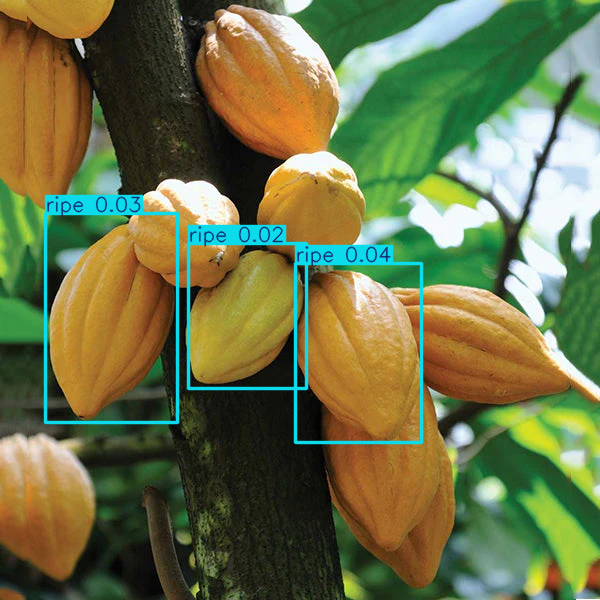

/content/sample_data/v7/test/images/theobroma_f745fb73-31c4-43ff-af96-08e5bcebff62.jpg

image 1/1 /content/sample_data/v7/test/images/theobroma_f745fb73-31c4-43ff-af96-08e5bcebff62.jpg: 288x320 2 ripes, 85.2ms
Speed: 1.5ms preprocess, 85.2ms inference, 0.6ms postprocess per image at shape (1, 3, 288, 320)


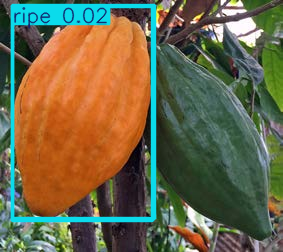

/content/sample_data/v7/test/images/cacao-tree-theobroma-cacao-organic-cocoa-fruit-pods-nature-chocolate-tree_37874-3796.avif

image 1/1 /content/sample_data/v7/test/images/cacao-tree-theobroma-cacao-organic-cocoa-fruit-pods-nature-chocolate-tree_37874-3796.avif: 224x320 (no detections), 70.5ms
Speed: 1.4ms preprocess, 70.5ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 320)


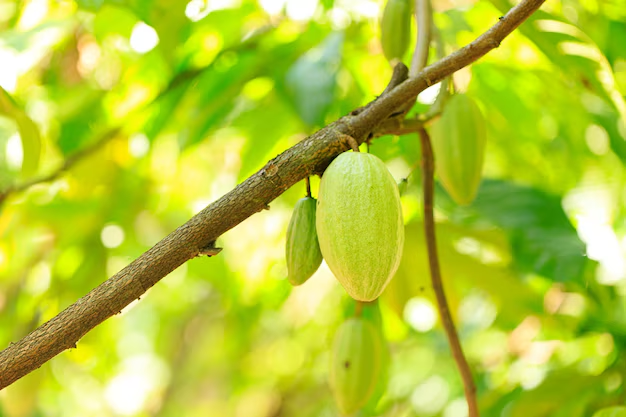

/content/sample_data/v7/test/images/cacao-fruit-grow-tree-green-39386296.webp

image 1/1 /content/sample_data/v7/test/images/cacao-fruit-grow-tree-green-39386296.webp: 224x320 2 ripes, 70.6ms
Speed: 1.9ms preprocess, 70.6ms inference, 0.7ms postprocess per image at shape (1, 3, 224, 320)


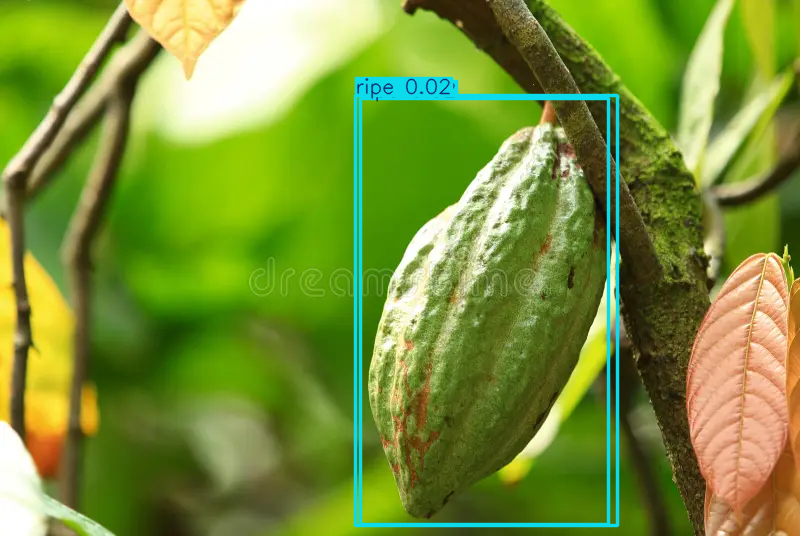

/content/sample_data/v7/test/images/images (7).jpg

image 1/1 /content/sample_data/v7/test/images/images (7).jpg: 288x320 1 ripe, 87.5ms
Speed: 1.5ms preprocess, 87.5ms inference, 0.5ms postprocess per image at shape (1, 3, 288, 320)


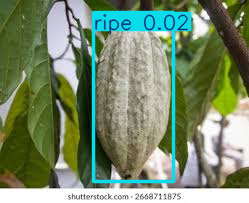

/content/sample_data/v7/test/images/pngtree-organic-cocoa-fruit-pods-of-cacao-tree-theobroma-cacao-in-their-natural-habitat-photo-image_31548062.jpg

image 1/1 /content/sample_data/v7/test/images/pngtree-organic-cocoa-fruit-pods-of-cacao-tree-theobroma-cacao-in-their-natural-habitat-photo-image_31548062.jpg: 224x320 2 ripes, 85.4ms
Speed: 3.8ms preprocess, 85.4ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 320)


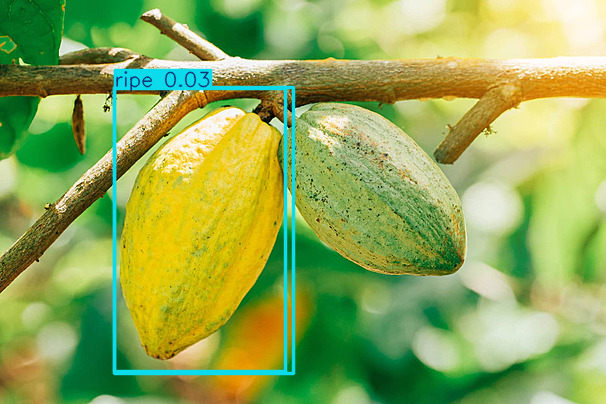

/content/sample_data/v7/test/images/images (4).jpg

image 1/1 /content/sample_data/v7/test/images/images (4).jpg: 224x320 (no detections), 90.5ms
Speed: 1.9ms preprocess, 90.5ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 320)


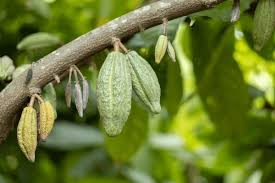

/content/sample_data/v7/test/images/cocoa-tree-with-fruits-yellow-green-cocoa-pods-grow-tree_37874-10521.avif

image 1/1 /content/sample_data/v7/test/images/cocoa-tree-with-fruits-yellow-green-cocoa-pods-grow-tree_37874-10521.avif: 224x320 (no detections), 67.9ms
Speed: 1.5ms preprocess, 67.9ms inference, 0.8ms postprocess per image at shape (1, 3, 224, 320)


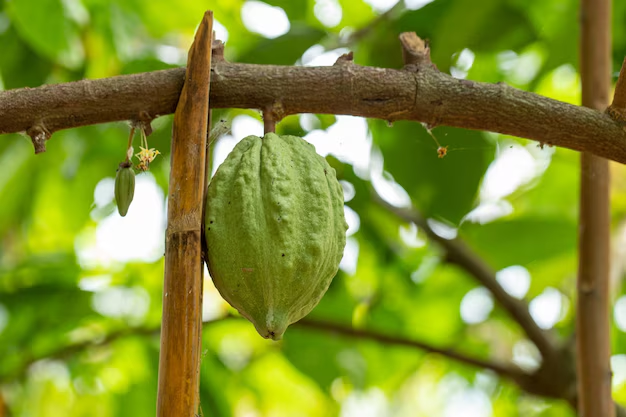

In [20]:
images_folder = "/content/sample_data/v7/test/images"
for fl in os.listdir(images_folder):
  flpath = os.path.join(images_folder, fl)
  print(flpath)
  results =fruit_model.predict(flpath, conf=0.019)
  results[0].show()